In [1]:
import pandas as pd
import numpy as np 
import math as mt
import s3fs
import zipfile
import os
import matplotlib.pyplot as plt

class s3_connection():
    def __init__(self):
        """
        établir la connexion et après utiliser les fonction de read et write 
        """
        try:
         s3 = s3fs.S3FileSystem(client_kwargs={"endpoint_url": "https://minio.lab.sspcloud.fr"})
         
         print("connection successful")
         
        except:
         s3="connection not established, debug "
         print(s3)
        self.s3=s3
    def listt(self, directory):
        return((self.s3.ls(directory)))

    def unzip(self,from_s,to_s):
      with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
            zip_ref.extractall(extract_to_path)

    
    def from_pandas_to_parquet_store_in_s3(self,df, directory):
      try:
        with self.s3.open(directory, "wb") as file_out:
         df.to_parquet(file_out)
      except: 
        print("Cher lecteur, cette fonction écrit dans le dossier spécifié, mais vous n'avez pas les droits :( ")
      
    
    def get_tables_from_s3(self,directory):
        
        with self.s3.open(directory, "rb") as file_in:
          df = pd.read_parquet(file_in)
        return df
 
  
    
s3=s3_connection()
directory="aayrapetyan/diffusion/"
tables=s3.listt(directory)

dataframes = {}
words_to_remove = ["aayrapetyan", "diffusion", ".us", "--", "usd-spot","parquet"]
import re
# Loop through all files in the folder
for file_name in tables:
    if file_name.endswith('.parquet') and "final_table" not in file_name:  # Check if the file is a Parquet file
        
        try:
            # Read the Parquet file into a DataFrame
            df = s3.get_tables_from_s3(file_name)
            # Store the DataFrame using the file name (without extension) as the key
            pattern = "|".join(re.escape(word) for word in words_to_remove)
            cleaned_string = re.sub(pattern, "", file_name)
            cleaned_string = re.sub(r"[/\.]+", "/", cleaned_string).strip("/")[0:-1]
            dataframes[cleaned_string] = df
            print(f"Loaded {file_name} successfully!")
        except Exception as e:
            print(f"Error loading {file_name}: {e}")

for key in dataframes.keys():
    print(key)

dataframes["ftx-dai"]
def remove_outliers(df, columns):
    """
    Remove outliers from the specified columns of a DataFrame.
    Outliers are defined as values that are more than 3 standard deviations away from the mean.
    Prints the number of outliers removed for each column.
    """
    for column in columns:
        if column in df.columns:
            # Calcul des bornes
            mean = df[column].mean()
            std = df[column].std()
            lower_bound = mean - 3 * std
            upper_bound = mean + 3 * std
            # Calcul du nombre de valeurs initiales
            initial_count = len(df)
            # Filtrage des valeurs dans les bornes
            df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
            # Nombre de valeurs supprimées
            final_count = len(df)
            print(f"{column}: {(initial_count - final_count)/initial_count} %outliers removed")
    return df


def mark_outliers(df, columns):
    """
    Mark outliers in the specified columns of a DataFrame.
    Outliers are defined as values that are more than 3 standard deviations away from the mean.
    A new column '{column}_outlier' is added, initialized to 0, and set to 1 if the value is an outlier.
    """
    df = df.copy() # Pour éviter de modifier l'original directement
    for column in columns:
        if column in df.columns:
            # Calcul des bornes
            mean = df[column].mean()
            std = df[column].std()
            lower_bound = mean - 3 * std
            upper_bound = mean + 3 * std
            # Création de la colonne binaire d'outliers
            df[f"{column}_outlier"] = ((df[column] < lower_bound) | (df[column] > upper_bound)).astype(int)
            # Nombre d'outliers détectés
            outlier_count = df[f"{column}_outlier"].sum()
            print(f"{column}: {outlier_count} outliers marked")
    return df

def plot_stablecoin_prices(stablecoin, title, dataframes):
    """
    Plots stablecoin prices over time.
    If the outlier column exists, normal values are plotted in blue and outliers in red.
    Otherwise, the function plots all values in a single color.
    """
    plt.figure(figsize=(30, 6))
    
    df = dataframes[stablecoin]

    print(df.columns)
    
    if f"price_outlier" in df.columns:
        print("ok")
        # Séparer les valeurs normales et les outliers
        normal_values = df[df[f"price_outlier"] == 0]
        outliers = df[df[f"price_outlier"] == 1]

        # Tracer les valeurs normales en bleu
        plt.plot(normal_values['time'], normal_values['price'], color='blue', label='Normal Values')

        # Tracer les outliers en rouge
        plt.scatter(outliers['time'], outliers['price'], color='red', label='Outliers', zorder=3)
    else:
        print("else")
        # Tracer normalement si la colonne outlier n'existe pas
        plt.plot(df['time'], df['price'], color='blue', label='Price')

    plt.xlabel('Time')
    plt.ylabel('Price')
    plt.title(title)
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_stablecoin_prices_multi(stablecoins, title, dataframes):
    """
    Trace les prix de plusieurs stablecoins sur le même graphique.
    """
    
    plt.figure(figsize=(32, 6))
    for stablecoin in stablecoins:
        if stablecoin in dataframes:
            df = dataframes[stablecoin]
            plt.plot(df['time'], df['price'], label=stablecoin)

    plt.xlabel('Time')
    plt.ylabel('Price')
    plt.title(title)
    plt.legend()
    plt.grid(True)
    plt.show()

def aggreg(coin, plateform, type):
    # Vérifier que type est bien dans les valeurs attendues
    if type not in ["day", "hour", "minute"]:
        
        raise ValueError("Type must be 'day', 'hour', or 'minute'")

    # df = copy.deepcopy(dataframes) ## trop long à executer
    
    df = dataframes[f"{plateform}-{coin}"].copy()
    df["time"] = df["time"].dt.floor("D" if type == "day" else "H" if type == "hour" else "T")
    dataframes[f"{type}-{plateform}-{coin}"] = df.groupby("time", as_index=False)["price"].mean()


connection successful
Loaded aayrapetyan/diffusion/binance.us-dai-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/binance.us-usdc-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/binance.us-usdt-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/coinbase-dai-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/coinbase-usdt-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/coinbase-wluna-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/ftx-cusdt-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/ftx-dai-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/ftx-luna-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/kraken-dai-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/kraken-luna-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/kraken-usdc-usd-spot.parquet successfully!
Loaded aayrapetyan/diffusion/kraken-usdt-usd-spot.parquet successfully!
binance-dai
binance-usdc
binance-us

In [2]:
aggreg("usdc","binance","hour")
aggreg("usdc","binance","minute")
aggreg("usdc","binance","day")
aggreg("usdc","kraken","hour")
aggreg("usdc","kraken","minute")
aggreg("usdc","kraken","day")



dataframes["new-hour-binance-usdc"]= remove_outliers(dataframes["hour-binance-usdc"],["price"])
dataframes["new-hour-kraken-usdc"]= remove_outliers(dataframes["hour-kraken-usdc"],["price"])
dataframes["new-day-binance-usdc"]= remove_outliers(dataframes["day-binance-usdc"],["price"])
dataframes["new-day-kraken-usdc"]= remove_outliers(dataframes["day-kraken-usdc"],["price"])
dataframes["new-minute-binance-usdc"]= remove_outliers(dataframes["minute-binance-usdc"],["price"])
dataframes["new-minute-kraken-usdc"]= remove_outliers(dataframes["minute-kraken-usdc"],["price"])

/tmp/ipykernel_137968/3054670655.py:180: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df["time"] = df["time"].dt.floor("D" if type == "day" else "H" if type == "hour" else "T")
/tmp/ipykernel_137968/3054670655.py:180: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  df["time"] = df["time"].dt.floor("D" if type == "day" else "H" if type == "hour" else "T")
/tmp/ipykernel_137968/3054670655.py:180: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df["time"] = df["time"].dt.floor("D" if type == "day" else "H" if type == "hour" else "T")
/tmp/ipykernel_137968/3054670655.py:180: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  df["time"] = df["time"].dt.floor("D" if type == "day" else "H" if type == "hour" else "T")


price: 0.0002295684113865932 %outliers removed
price: 0.005253540429419826 %outliers removed
price: 0.0027397260273972603 %outliers removed
price: 0.021917808219178082 %outliers removed
price: 2.8890461814032097e-05 %outliers removed
price: 0.0025597367127952555 %outliers removed


Index(['time', 'price'], dtype='object')
else


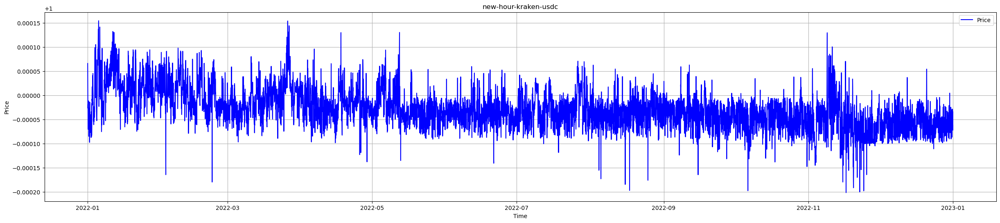

Index(['time', 'price'], dtype='object')
else


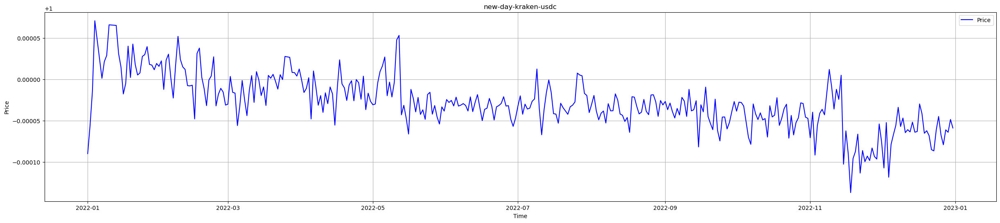

In [78]:
# plot_stablecoin_prices("new-hour-binance-usdc", "new-hour-binance-usdc", dataframes)
plot_stablecoin_prices("new-hour-kraken-usdc", "new-hour-kraken-usdc", dataframes)
#plot_stablecoin_prices("new-day-binance-usdc", "new-day-binance-usdc", dataframes)
plot_stablecoin_prices("new-day-kraken-usdc", "new-day-kraken-usdc", dataframes)
#plot_stablecoin_prices("new-minute-binance-usdc", "new-minute-binance-usdc", dataframes)
#plot_stablecoin_prices("new-minute-kraken-usdc", "new-minute-kraken-usdc", dataframes)

## Je décide de m'interesser à kraken usdc day 

Moyennes , variances

In [79]:
def boxplots(coin="dai"):
   # Given means and standard deviations for 3 categories
   table_names=[key for key,_ in dataframes.items() if coin  in key and "new" in key]
   N=len(table_names)
   means = [float(dataframes[table_name]["price"].mean()) for table_name in table_names]  # Example standard deviations
   std_devs = [float(dataframes[table_name]["price"].std()) for table_name in table_names] 
   # Estimating boxplot values based on a normal distribution assumption
   q1 = [means[i] - 0.675 * std_devs[i] for i in range(N)]
   q3 = [means[i] + 0.675 * std_devs[i] for i in range(N)]
   medians = means  # Assuming normality
   whisker_min = [means[i] - 1.5 * std_devs[i] for i in range(N)]
   whisker_max = [means[i] + 1.5 * std_devs[i] for i in range(N)]
   
   # Creating boxplot data
   box_data = [ 
       [whisker_min[i], q1[i], medians[i], q3[i], whisker_max[i]] 
       for i in range(N)
   ]
   
   # Creating the boxplot
   fig, ax = plt.subplots()
   ax.boxplot(box_data, vert=True, patch_artist=True, labels=[el.replace("new","") for el in table_names])
   
   # Formatting
   ax.set_title("Estimated Boxplot from Mean and Standard Deviation, normal time")
   ax.set_ylabel("Values")

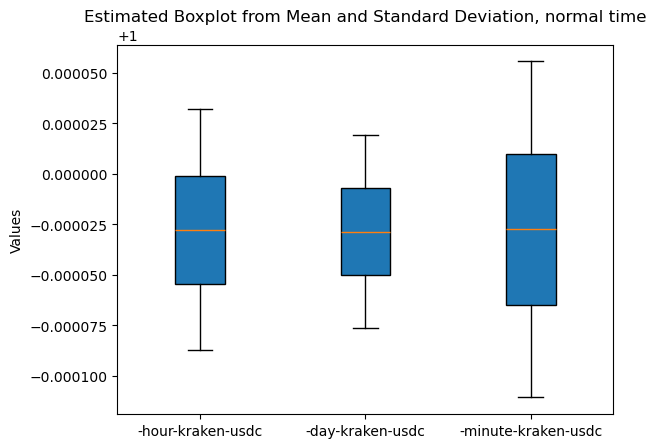

In [80]:
boxplots("kraken")

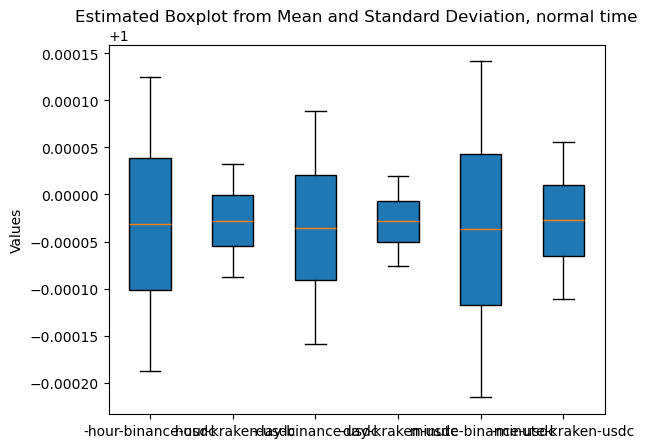

In [81]:
boxplots("usdc")

In [82]:
pip install arch

Note: you may need to restart the kernel to use updated packages.


ACF PACF

Stationarity tests for kraken-usdc (hour data):
  - ADF p-value: 0.0934
  - PP p-value: 0.0
  - KPSS p-value: 0.01


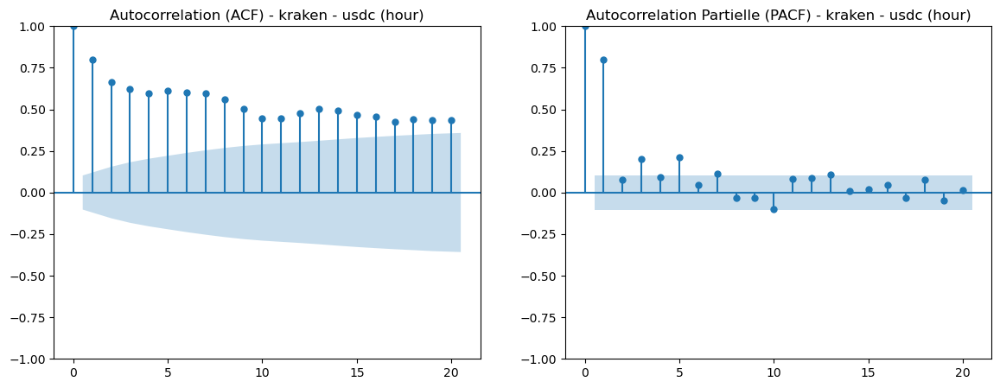

Stationarity tests for kraken-usdc (day data):
  - ADF p-value: 0.1027
  - PP p-value: 0.0
  - KPSS p-value: 0.01


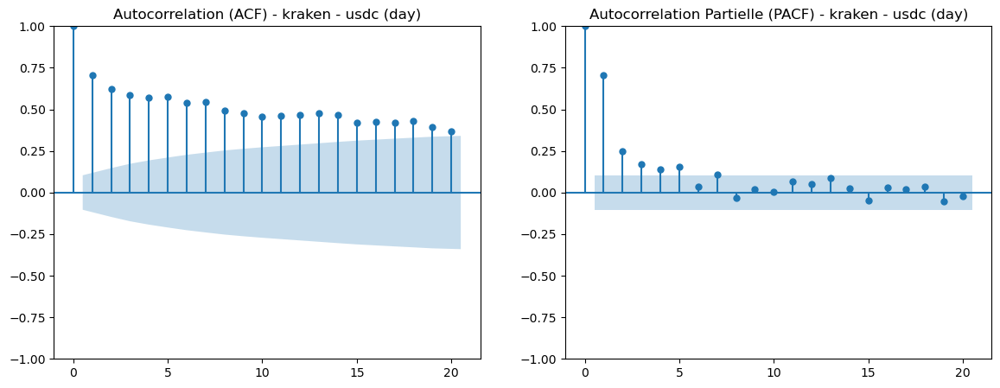

Stationarity tests for binance-usdc (hour data):
  - ADF p-value: 0.0002
  - PP p-value: 0.0
  - KPSS p-value: 0.0175


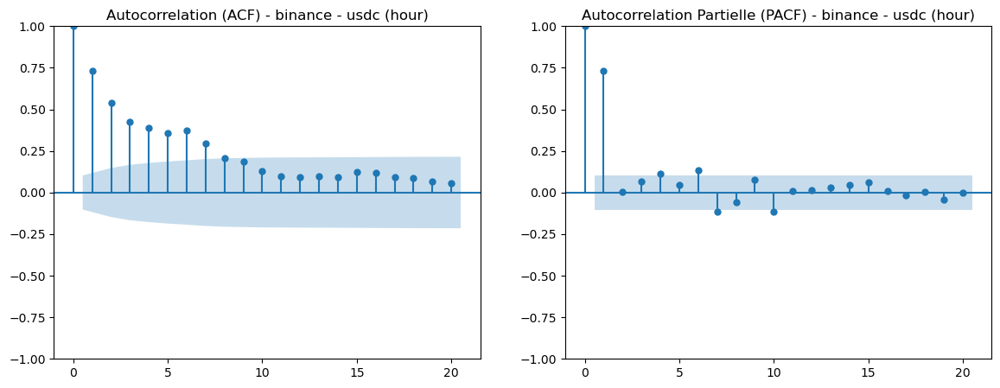

Stationarity tests for binance-usdc (day data):
  - ADF p-value: 0.0
  - PP p-value: 0.0
  - KPSS p-value: 0.01


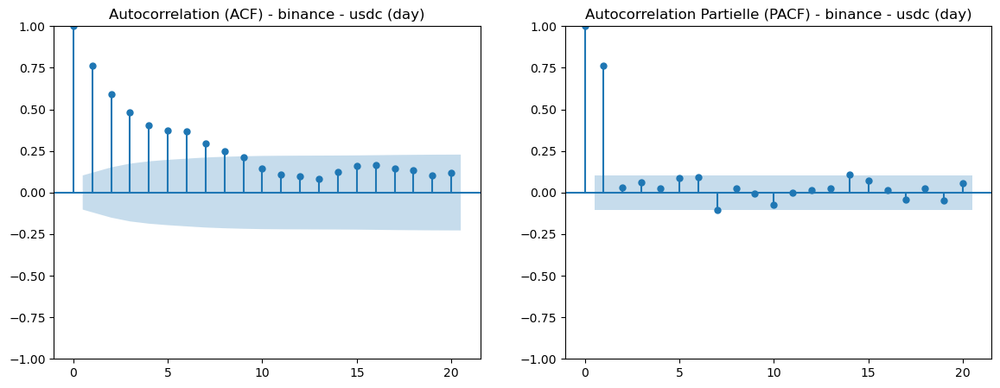

In [83]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller, kpss
from arch.unitroot import PhillipsPerron

def stationarity_test_acp_pacf(coin, plateform, type, without_outliers):
    # Sélection du DataFrame en fonction du paramètre without_outliers
    if without_outliers:
        df_key = f"new-{type}-{plateform}-{coin}"
    else:
        df_key = f"{type}-{plateform}-{coin}"
    
    if df_key not in dataframes:
        raise KeyError(f"Le DataFrame {df_key} n'existe pas dans dataframes.")
    
    df = dataframes[df_key].copy()
    
    # Conversion de la colonne time en date
    df["date"] = df["time"].dt.date
    
    df_grouped = df.groupby("date", as_index=False)["price"].mean()
    
    # Vérification de la stationnarité avec les tests ADF, PP et KPSS
    adf_test = adfuller(df_grouped["price"])
    pp_test = PhillipsPerron(df_grouped["price"]).pvalue
    kpss_test = kpss(df_grouped["price"], regression='c')
    
    print(f"Stationarity tests for {plateform}-{coin} ({type} data):")
    print(f"  - ADF p-value: {np.round(float(adf_test[1]), 4)}")
    print(f"  - PP p-value: {np.round(float(pp_test), 4)}")
    print(f"  - KPSS p-value: {np.round(float(kpss_test[1]), 4)}")
    
    # Tracer les graphiques ACF et PACF
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))
    
    sm.graphics.tsa.plot_acf(df_grouped["price"], ax=axes[0], lags=20)
    axes[0].set_title(f"Autocorrelation (ACF) - {plateform} - {coin} ({type})")
    
    sm.graphics.tsa.plot_pacf(df_grouped["price"], ax=axes[1], lags=20)
    axes[1].set_title(f"Autocorrelation Partielle (PACF) - {plateform} - {coin} ({type})")
    
    plt.show()

# Exemple d'appel de la fonction
# stationarity_test_acp_pacf("usdc", "kraken", "hour", True)
# Exemple d'appel de la fonction
# stationarity_test_acp_pacf("usdc", "kraken", "hour", True)

stationarity_test_acp_pacf("usdc", "kraken", "hour", True)

stationarity_test_acp_pacf("usdc", "kraken", "day", True)

stationarity_test_acp_pacf("usdc", "binance", "hour", True)

stationarity_test_acp_pacf("usdc", "binance", "day", True)


Index(['time', 'price'], dtype='object')
else


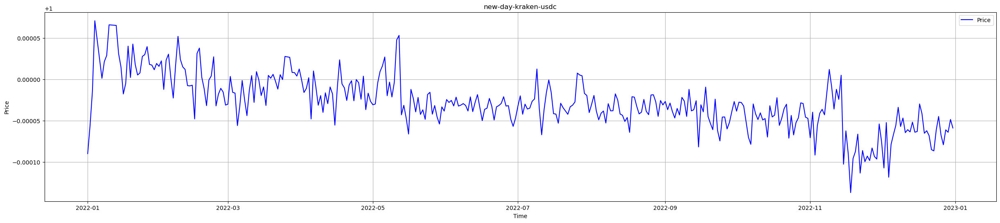

Index(['time', 'price'], dtype='object')
else


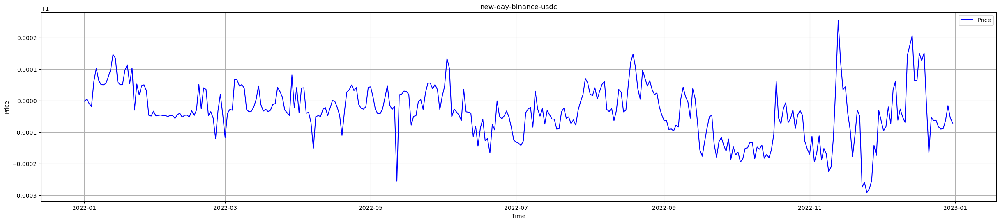

In [84]:

plot_stablecoin_prices("new-day-kraken-usdc", "new-day-kraken-usdc", dataframes)

plot_stablecoin_prices("new-day-binance-usdc", "new-day-binance-usdc", dataframes)

## On s'interesse pour le moment à day, Sur kraken, les tests ne nous permettent pas de dire que la série est stationnaire, alors que sur coinbase oui.

Je vais donc essayer de modifier sur kraken pour rendre stationnaire

## Diff transfo

/tmp/ipykernel_137968/3076004337.py:25: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_test = kpss(df_grouped["price_diff"].dropna(), regression='c')


Stationarity tests after differencing for kraken-usdc (day data):
  - ADF p-value: 0.0
  - PP p-value: 0.0
  - KPSS p-value: 0.1


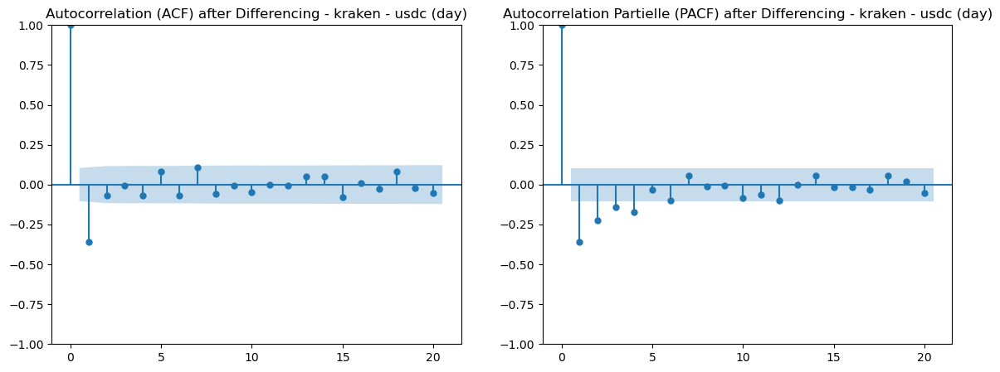

In [4]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller, kpss
from arch.unitroot import PhillipsPerron

def stationarity_transformation_diff(coin, plateform, type, without_outliers):
    # Sélection du DataFrame en fonction du paramètre without_outliers
    if without_outliers:
        df_key = f"new-{type}-{plateform}-{coin}"
    else:
        df_key = f"{type}-{plateform}-{coin}"
    
    if df_key not in dataframes:
        raise KeyError(f"Le DataFrame {df_key} n'existe pas dans dataframes.")
    df_grouped = dataframes[df_key].copy()
    
    # Transformation : Différenciation première
    df_grouped["price_diff"] = df_grouped["price"].diff().dropna() #X_t' = X_t - X_t-1
    
    # Vérification de la stationnarité après différenciation
    adf_test = adfuller(df_grouped["price_diff"].dropna())
    pp_test = PhillipsPerron(df_grouped["price_diff"].dropna()).pvalue
    kpss_test = kpss(df_grouped["price_diff"].dropna(), regression='c')
    
    print(f"Stationarity tests after differencing for {plateform}-{coin} ({type} data):")
    print(f"  - ADF p-value: {np.round(float(adf_test[1]), 4)}")
    print(f"  - PP p-value: {np.round(float(pp_test), 4)}")
    print(f"  - KPSS p-value: {np.round(float(kpss_test[1]), 4)}")
    
    # Tracer les graphiques ACF et PACF après différenciation
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))
    
    sm.graphics.tsa.plot_acf(df_grouped["price_diff"].dropna(), ax=axes[0], lags=20)
    axes[0].set_title(f"Autocorrelation (ACF) after Differencing - {plateform} - {coin} ({type})")
    
    sm.graphics.tsa.plot_pacf(df_grouped["price_diff"].dropna(), ax=axes[1], lags=20)
    axes[1].set_title(f"Autocorrelation Partielle (PACF) after Differencing - {plateform} - {coin} ({type})")
    
    plt.show()

# Exemple d'appel de la fonction
stationarity_transformation_diff("usdc", "kraken", "day", True)


## Log transformation (ne change rien à la stationnarité normalement mais permet de diminuer la variance)

/tmp/ipykernel_137968/491835260.py:25: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_test = kpss(df_grouped["price_log"].dropna(), regression='c')


Stationarity tests after differencing for kraken-usdc (day data):
  - ADF p-value: 0.1027
  - PP p-value: 0.0
  - KPSS p-value: 0.01


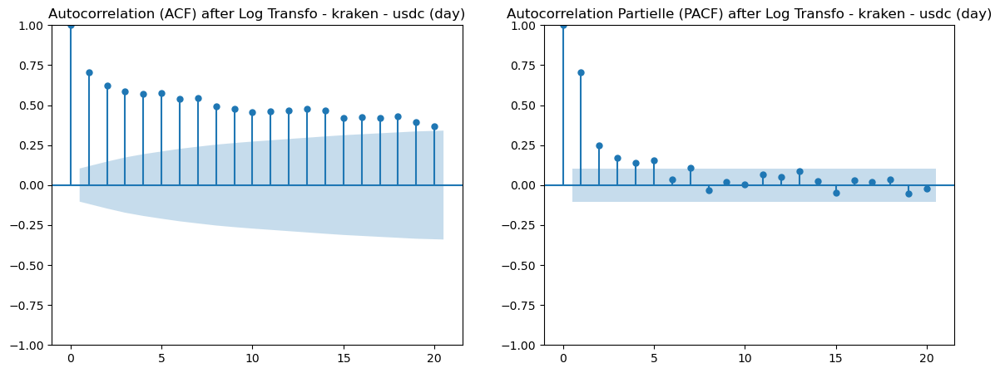

In [5]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller, kpss
from arch.unitroot import PhillipsPerron

def stationarity_transformation_log(coin, plateform, type, without_outliers):
    # Sélection du DataFrame en fonction du paramètre without_outliers
    if without_outliers:
        df_key = f"new-{type}-{plateform}-{coin}"
    else:
        df_key = f"{type}-{plateform}-{coin}"
    
    if df_key not in dataframes:
        raise KeyError(f"Le DataFrame {df_key} n'existe pas dans dataframes.")
    df_grouped = dataframes[df_key].copy()
    
    # Transformation : Différenciation première
    df_grouped["price_log"] = np.log(df_grouped["price"])    #Y_t = log(X_t)
    
    # Vérification de la stationnarité après différenciation
    adf_test = adfuller(df_grouped["price_log"].dropna())
    pp_test = PhillipsPerron(df_grouped["price_log"].dropna()).pvalue
    kpss_test = kpss(df_grouped["price_log"].dropna(), regression='c')
    
    print(f"Stationarity tests after differencing for {plateform}-{coin} ({type} data):")
    print(f"  - ADF p-value: {np.round(float(adf_test[1]), 4)}")
    print(f"  - PP p-value: {np.round(float(pp_test), 4)}")
    print(f"  - KPSS p-value: {np.round(float(kpss_test[1]), 4)}")
    
    # Tracer les graphiques ACF et PACF après différenciation
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))
    
    sm.graphics.tsa.plot_acf(df_grouped["price_log"].dropna(), ax=axes[0], lags=20)
    axes[0].set_title(f"Autocorrelation (ACF) after Log Transfo - {plateform} - {coin} ({type})")
    
    sm.graphics.tsa.plot_pacf(df_grouped["price_log"].dropna(), ax=axes[1], lags=20)
    axes[1].set_title(f"Autocorrelation Partielle (PACF) after Log Transfo - {plateform} - {coin} ({type})")
    
    plt.show()

# Exemple d'appel de la fonction
stationarity_transformation_log("usdc", "kraken", "day", True)


## Conclusion : Avec une diff, on rend la série stationnaire pour day kraken usdc

# Arima

## ARIMA(3,1,3) à log transformation

/tmp/ipykernel_102297/4216999322.py:27: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.




Stationarity tests after log transformation for kraken-usdc (day data):
  - ADF p-value: 0.1027
  - PP p-value: 0.0
  - KPSS p-value: 0.01


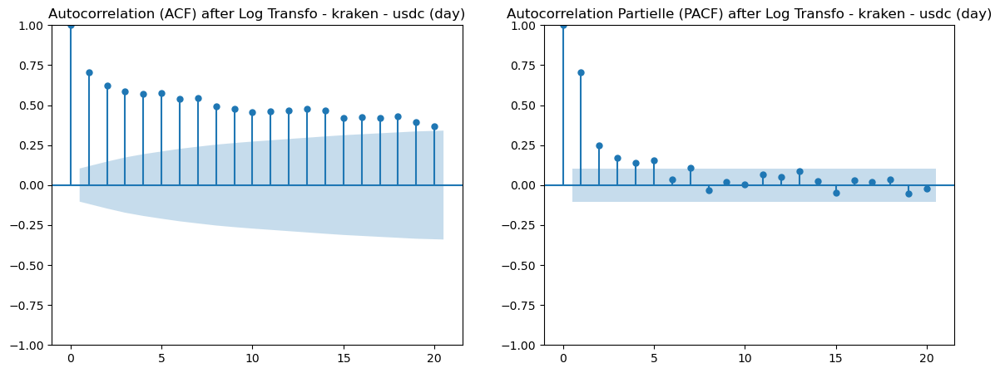

                               SARIMAX Results                                
Dep. Variable:              price_log   No. Observations:                  357
Model:                 ARIMA(3, 1, 3)   Log Likelihood                3299.487
Date:                Wed, 19 Mar 2025   AIC                          -6584.974
Time:                        16:28:53   BIC                          -6557.849
Sample:                             0   HQIC                         -6574.184
                                - 357                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7270   2.63e-20  -2.76e+19      0.000      -0.727      -0.727
ar.L2          0.2193   4.52e-20   4.85e+18      0.000       0.219       0.219
ar.L3          0.0922    2.4e-20   3.85e+18      0.0

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:837: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/opt/conda/lib/python3.12/site-packages/st

In [6]:
import numpy as np
import plotly.graph_objects as go
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller, kpss
from arch.unitroot import PhillipsPerron
from statsmodels.tsa.arima.model import ARIMA

def ARIMA_log(coin, plateform, type, without_outliers):
    # Sélection du DataFrame en fonction du paramètre without_outliers
    if without_outliers:
        df_key = f"new-{type}-{plateform}-{coin}"
    else:
        df_key = f"{type}-{plateform}-{coin}"
    
    if df_key not in dataframes:
        raise KeyError(f"Le DataFrame {df_key} n'existe pas dans dataframes.")
    df_grouped = dataframes[df_key].copy()
    
    # Transformation : Logarithme
    df_grouped["price_log"] = np.log(df_grouped["price"])    # Y_t = log(X_t)
    
    # Vérification de la stationnarité après transformation
    adf_test = adfuller(df_grouped["price_log"].dropna())
    pp_test = PhillipsPerron(df_grouped["price_log"].dropna()).pvalue
    kpss_test = kpss(df_grouped["price_log"].dropna(), regression='c')
    
    print(f"Stationarity tests after log transformation for {plateform}-{coin} ({type} data):")
    print(f"  - ADF p-value: {np.round(float(adf_test[1]), 4)}")
    print(f"  - PP p-value: {np.round(float(pp_test), 4)}")
    print(f"  - KPSS p-value: {np.round(float(kpss_test[1]), 4)}")
    
    # Tracer les graphiques ACF et PACF après transformation
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))
    
    sm.graphics.tsa.plot_acf(df_grouped["price_log"].dropna(), ax=axes[0], lags=20)
    axes[0].set_title(f"Autocorrelation (ACF) after Log Transfo - {plateform} - {coin} ({type})")
    
    sm.graphics.tsa.plot_pacf(df_grouped["price_log"].dropna(), ax=axes[1], lags=20)
    axes[1].set_title(f"Autocorrelation Partielle (PACF) after Log Transfo - {plateform} - {coin} ({type})")
    
    plt.show()
    
    # Modélisation ARIMA (p, d, q) = (1,1,1) comme modèle de base
    model = ARIMA(df_grouped["price_log"].dropna(), order=(3,1,3))
    results = model.fit()
    
    print(results.summary())

    # Tracé des prédictions
    df_grouped["forecast"] = results.predict(start=2, end=len(df_grouped))
    # On construit la figure Plotly
    fig = go.Figure()

    # Tracé des observations (points)
    fig.add_trace(go.Scatter(
        x=df_grouped["time"],
        y=df_grouped["price_log"],
        mode='lines',
        name="Original Log Price",
        marker=dict(color='red', size=4),
    ))

    
      # Tracé des estimations filtrées (ligne)
    fig.add_trace(go.Scatter(
        x=df_grouped["time"],
        y=df_grouped["forecast"],
        mode='lines',
        name='ARIMA Forecast',
        line=dict(color='blue')
    ))
 # Mise en forme
    fig.update_layout(
        title=f"ARIMA Forecast - {plateform} - {coin} ({type})",
        xaxis_title="Time",
        yaxis_title="Price",
        template="plotly_white",
        legend=dict(x=0, y=1),
        width=1500,   # largeur en pixels
        height=600
    )
    return fig
    

# Exemple d'appel de la fonction
ARIMA_log("usdc", "kraken", "day", True)


## Commentaires : plutot satisfaisant

### les p values des coeffs sont très faibles, les standards errors aussi et BIC et AIC sont <<0 

Les coefficients estimés du modèle sont les suivants :

Le terme AR(1) est négatif et significatif (−0.7270), ce qui signifie qu'une hausse du prix à 
𝑡−1 est généralement suivie d'une baisse à 𝑡 et vice-versa.
Le terme AR(2) est positif (
0.2193
0.2193), indiquant une légère influence des valeurs observées deux périodes auparavant.
Le terme AR(3) est également positif mais faible (
0.0922
0.0922), ce qui suggère que les valeurs passées au-delà de deux périodes ont une influence marginale.
Concernant les termes de moyenne mobile (MA) :

Le terme MA(1) est positif (
0.1276
0.1276), ce qui signifie que l'erreur observée une période plus tôt impacte légèrement la prévision actuelle.
Le terme MA(2) est fortement négatif (
−
0.7937
−0.7937), indiquant que l'erreur à 
𝑡
−
2
t−2 joue un rôle majeur dans l'ajustement du modèle.
Le terme MA(3) est très faible (
−
0.0800
−0.0800), ce qui signifie que l'effet des erreurs anciennes est limité.
L’évaluation statistique du modèle montre que :

L'AIC est de 
−
6584.974
−6584.974 et le BIC est de 
−
6557.849
−6557.849, ce qui indique un bon ajustement aux données.
Le test de Ljung-Box (Q-test) renvoie une valeur de 9.26 avec un 
𝑝
p-value de 0.00, suggérant que les résidus pourraient encore contenir une structure non modélisée.
Le test de Jarque-Bera (JB) donne une statistique de 157.11 avec un 
𝑝
p-value de 0.00, indiquant que les résidus ne suivent pas une distribution normale.

# Prédiction des 5 dernières valeurs

In [21]:
import numpy as np
import plotly.graph_objects as go
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller, kpss
from arch.unitroot import PhillipsPerron
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error, mean_absolute_error

def ARIMA_log(coin, plateform, type, without_outliers, validation_points=5):
    # Sélection du DataFrame en fonction du paramètre without_outliers
    if without_outliers:
        df_key = f"new-{type}-{plateform}-{coin}"
    else:
        df_key = f"{type}-{plateform}-{coin}"
    
    if df_key not in dataframes:
        raise KeyError(f"Le DataFrame {df_key} n'existe pas dans dataframes.")
    df_grouped = dataframes[df_key].copy()
    
    # Transformation : Logarithme
    df_grouped["price_log"] = np.log(df_grouped["price"])    # Y_t = log(X_t)
    
    # Séparation des données d'entraînement et de validation
    train_data = df_grouped.iloc[:-validation_points].copy()
    validation_data = df_grouped.iloc[-validation_points:].copy()
    
    print(f"Taille des données d'entraînement: {len(train_data)}")
    print(f"Taille des données de validation: {len(validation_data)}")
    
    # Vérification de la stationnarité après transformation (sur les données d'entraînement)
    adf_test = adfuller(train_data["price_log"].dropna())
    pp_test = PhillipsPerron(train_data["price_log"].dropna()).pvalue
    kpss_test = kpss(train_data["price_log"].dropna(), regression='c')
    
    print(f"Stationarity tests after log transformation for {plateform}-{coin} ({type} data):")
    print(f"  - ADF p-value: {np.round(float(adf_test[1]), 4)}")
    print(f"  - PP p-value: {np.round(float(pp_test), 4)}")
    print(f"  - KPSS p-value: {np.round(float(kpss_test[1]), 4)}")
    
    # # Tracer les graphiques ACF et PACF après transformation
    # fig, axes = plt.subplots(1, 2, figsize=(14, 5))
    
    # sm.graphics.tsa.plot_acf(train_data["price_log"].dropna(), ax=axes[0], lags=20)
    # axes[0].set_title(f"Autocorrelation (ACF) after Log Transfo - {plateform} - {coin} ({type})")
    
    # sm.graphics.tsa.plot_pacf(train_data["price_log"].dropna(), ax=axes[1], lags=20)
    # axes[1].set_title(f"Autocorrelation Partielle (PACF) after Log Transfo - {plateform} - {coin} ({type})")
    
    # plt.show()
    
    # Modélisation ARIMA (p, d, q) = (3,1,3) sur les données d'entraînement
    model = ARIMA(train_data["price_log"].dropna(), order=(3,1,3))
    results = model.fit()
    
    print(results.summary())

    # Prédictions sur l'ensemble des données
    # Prédictions in-sample (sur les données d'entraînement)
    in_sample_pred = results.predict(start=0, end=len(train_data)-1)
    # in_sample_pred = results.predict(start=train_data.index[0], end=train_data.index[-1])

    
    # Prédictions out-of-sample (sur les données de validation)
    # On prédit pour les périodes suivant la fin de l'entraînement
    out_sample_pred = results.forecast(steps=validation_points)
    
    # Évaluation de la qualité des prédictions sur la validation
    validation_actual = validation_data["price_log"].values
    mse = mean_squared_error(validation_actual, out_sample_pred)
    mae = mean_absolute_error(validation_actual, out_sample_pred)
    rmse = np.sqrt(mse)
    
    print(f"Métriques d'évaluation sur les données de validation:")
    print(f"  - MSE (Mean Squared Error): {mse:.6f}")
    print(f"  - RMSE (Root Mean Squared Error): {rmse:.6f}")
    print(f"  - MAE (Mean Absolute Error): {mae:.6f}")
    
    # Création du DataFrame pour les prédictions
    full_df = df_grouped.copy()
    
    # Ajout des prédictions in-sample
    full_df.loc[train_data.index[1:], "forecast"] = in_sample_pred
    
    # Ajout des prédictions out-of-sample
    full_df.loc[validation_data.index, "forecast"] = out_sample_pred
    
    # On construit la figure Plotly
    fig = go.Figure()

    # Tracé des observations (points)
    fig.add_trace(go.Scatter(
        x=full_df["time"],
        y=full_df["price_log"],
        mode='lines',
        name="Original Log Price",
        marker=dict(color='red', size=4),
    ))
    
    # Tracé des prédictions in-sample
    fig.add_trace(go.Scatter(
        x=full_df.loc[train_data.index[1:], "time"],
        y=full_df.loc[train_data.index[1:], "forecast"],
        mode='lines',
        name='ARIMA In-Sample Forecast',
        line=dict(color='blue')
    ))
    
    # Tracé des prédictions out-of-sample (validation)
    fig.add_trace(go.Scatter(
        x=full_df.loc[validation_data.index, "time"],
        y=full_df.loc[validation_data.index, "forecast"],
        mode='lines',
        name='ARIMA Out-of-Sample Forecast',
        line=dict(color='green', dash='dash')
    ))
    
    # Ajout d'une ligne verticale séparant les données d'entraînement et de validation
    split_time = train_data["time"].iloc[-1]
    fig.add_shape(
        type="line",
        x0=split_time,
        y0=full_df["price_log"].min(),
        x1=split_time,
        y1=full_df["price_log"].max(),
        line=dict(color="black", width=1, dash="dot"),
    )
    
    # Mise en forme
    fig.update_layout(
        title=f"ARIMA Forecast - {plateform} - {coin} ({type}) - {validation_points} points validation",
        xaxis_title="Time",
        yaxis_title="Log Price",
        template="plotly_white",
        legend=dict(x=0, y=1),
        width=1500,
        height=600
    )
    
    return fig, mse, rmse, mae

# Exemple d'appel de la fonction
fig, mse, rmse, mae = ARIMA_log("usdc", "kraken", "day", True, validation_points=5)
fig.show()

Taille des données d'entraînement: 352
Taille des données de validation: 5
Stationarity tests after log transformation for kraken-usdc (day data):
  - ADF p-value: 0.1181
  - PP p-value: 0.0
  - KPSS p-value: 0.01
                               SARIMAX Results                                
Dep. Variable:              price_log   No. Observations:                  352
Model:                 ARIMA(3, 1, 3)   Log Likelihood                3252.116
Date:                Wed, 19 Mar 2025   AIC                          -6490.233
Time:                        23:20:07   BIC                          -6463.207
Sample:                             0   HQIC                         -6479.477
                                - 352                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------

/tmp/ipykernel_137968/3444668430.py:35: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.


/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/opt/conda/lib/python3.12/site-package

# Etude des bruits de l'Arima : 

Arch(1)

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/tmp/ipykernel_137968/4244362098.py:30: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.




Tests de stationnarité des bruits de l'ARIMA (kraken-usdc - day)
  - ADF p-value: 0.0
  - PP p-value: 0.0
  - KPSS p-value: 0.1


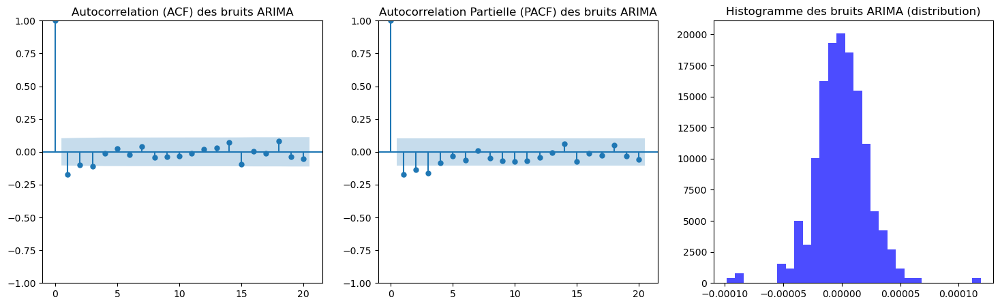

Test de Ljung-Box (p-value) : 0.0198

Modélisation de la volatilité des résidus avec ARCH(3)...
                      Constant Mean - ARCH Model Results                      
Dep. Variable:              residuals   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                       ARCH   Log-Likelihood:                3329.57
Distribution:                  Normal   AIC:                          -6653.13
Method:            Maximum Likelihood   BIC:                          -6641.50
                                        No. Observations:                  357
Date:                Wed, Mar 19 2025   Df Residuals:                      356
Time:                        23:09:35   Df Model:                            1
                                  Mean Model                                  
                  coef    std err          t      P>|t|       95.0% Conf. Int.
-----------------------------------

/opt/conda/lib/python3.12/site-packages/arch/univariate/base.py:309: DataScaleWarning:

y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 5.156e-10. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 1e+05 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.


/opt/conda/lib/python3.12/site-packages/arch/univariate/base.py:768: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




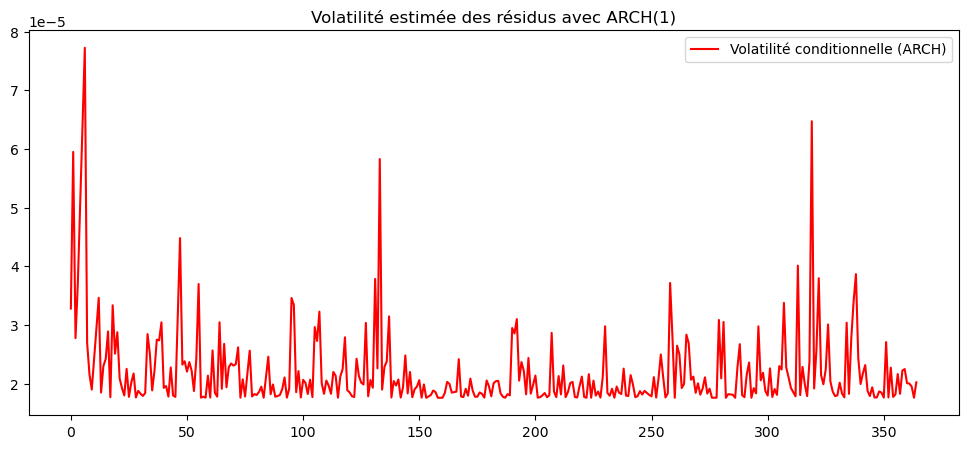

In [18]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller, kpss
from arch.unitroot import PhillipsPerron
from statsmodels.tsa.arima.model import ARIMA
from arch import arch_model

def analyse_bruit_arch(coin, plateform, type, without_outliers):
    # Sélection du DataFrame
    df_key = f"new-{type}-{plateform}-{coin}" if without_outliers else f"{type}-{plateform}-{coin}"
    if df_key not in dataframes:
        raise KeyError(f"Le DataFrame {df_key} n'existe pas dans dataframes.")
    df_grouped = dataframes[df_key].copy()
    
    # Transformation : Logarithme
    df_grouped["price_log"] = np.log(df_grouped["price"])  # Y_t = log(X_t)
    
    # Modélisation ARIMA (p, d, q) = (3,1,3)
    model = ARIMA(df_grouped["price_log"].dropna(), order=(3,1,3))
    results = model.fit()
    
    # Extraction des résidus (bruits)
    df_grouped["residuals"] = results.resid
    
    # Vérification de la stationnarité des bruits
    adf_test = adfuller(df_grouped["residuals"].dropna())
    pp_test = PhillipsPerron(df_grouped["residuals"].dropna()).pvalue
    kpss_test = kpss(df_grouped["residuals"].dropna(), regression='c')
    
    print(f"Tests de stationnarité des bruits de l'ARIMA ({plateform}-{coin} - {type})")
    print(f"  - ADF p-value: {np.round(adf_test[1], 4)}")
    print(f"  - PP p-value: {np.round(pp_test, 4)}")
    print(f"  - KPSS p-value: {np.round(kpss_test[1], 4)}")
    
    # Tracer les graphiques
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    
    # ACF et PACF des résidus
    sm.graphics.tsa.plot_acf(df_grouped["residuals"].dropna(), ax=axes[0], lags=20)
    axes[0].set_title("Autocorrelation (ACF) des bruits ARIMA")
    
    sm.graphics.tsa.plot_pacf(df_grouped["residuals"].dropna(), ax=axes[1], lags=20)
    axes[1].set_title("Autocorrelation Partielle (PACF) des bruits ARIMA")
    
    # Histogramme des résidus
    axes[2].hist(df_grouped["residuals"].dropna(), bins=30, density=True, alpha=0.7, color='blue')
    axes[2].set_title("Histogramme des bruits ARIMA (distribution)")
    
    plt.show()
    
    # Test de Ljung-Box
    ljung_box_p_values = sm.stats.acorr_ljungbox(df_grouped["residuals"].dropna(), lags=[10], return_df=True)
    print(f"Test de Ljung-Box (p-value) : {ljung_box_p_values['lb_pvalue'].values[0]:.4f}")
    
    # Analyse de la volatilité avec un modèle ARCH(3)
    print("\nModélisation de la volatilité des résidus avec ARCH(3)...")
    arch_model_fit = arch_model(df_grouped["residuals"].dropna(), vol='ARCH', p=1)
    arch_results = arch_model_fit.fit(disp='off')
    print(arch_results.summary())
    
    # Tracé de la volatilité estimée
    plt.figure(figsize=(12, 5))
    plt.plot(arch_results.conditional_volatility, label="Volatilité conditionnelle (ARCH)", color='red')
    plt.title("Volatilité estimée des résidus avec ARCH(1)")
    plt.legend()
    plt.show()
    
    return df_grouped["residuals"].dropna()

# Exemple d'appel de la fonction
bruit = analyse_bruit_arch("usdc", "kraken", "day", True)


Arch(3)

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/tmp/ipykernel_137968/2985779406.py:30: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.




Tests de stationnarité des bruits de l'ARIMA (kraken-usdc - day)
  - ADF p-value: 0.0
  - PP p-value: 0.0
  - KPSS p-value: 0.1


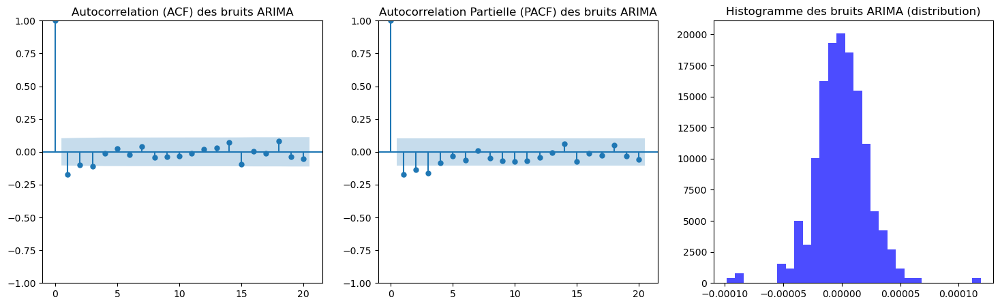

Test de Ljung-Box (p-value) : 0.0198

Modélisation de la volatilité des résidus avec ARCH(3)...
                      Constant Mean - ARCH Model Results                      
Dep. Variable:              residuals   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                       ARCH   Log-Likelihood:                3332.24
Distribution:                  Normal   AIC:                          -6654.48
Method:            Maximum Likelihood   BIC:                          -6635.09
                                        No. Observations:                  357
Date:                Wed, Mar 19 2025   Df Residuals:                      356
Time:                        23:10:08   Df Model:                            1
                                  Mean Model                                  
                  coef    std err          t      P>|t|       95.0% Conf. Int.
-----------------------------------

/opt/conda/lib/python3.12/site-packages/arch/univariate/base.py:309: DataScaleWarning:

y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 5.156e-10. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 1e+05 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.


/opt/conda/lib/python3.12/site-packages/arch/univariate/base.py:768: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




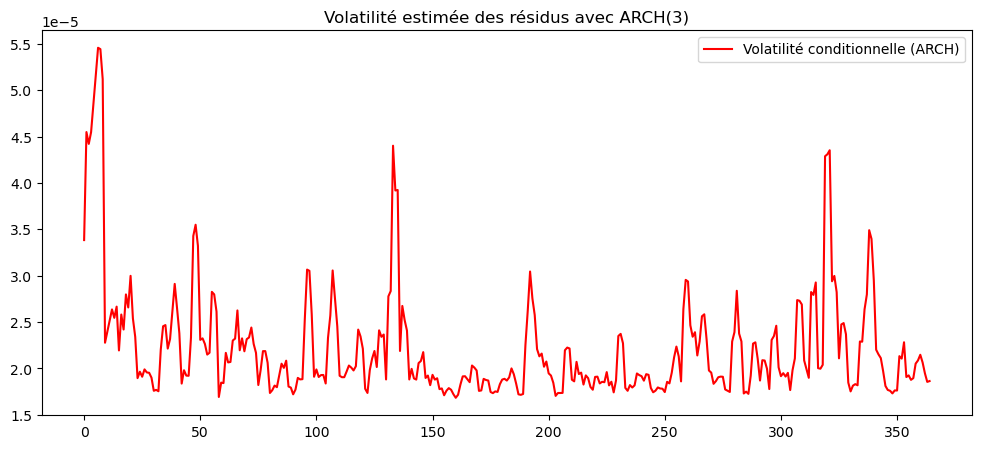

In [19]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller, kpss
from arch.unitroot import PhillipsPerron
from statsmodels.tsa.arima.model import ARIMA
from arch import arch_model

def analyse_bruit_arch(coin, plateform, type, without_outliers):
    # Sélection du DataFrame
    df_key = f"new-{type}-{plateform}-{coin}" if without_outliers else f"{type}-{plateform}-{coin}"
    if df_key not in dataframes:
        raise KeyError(f"Le DataFrame {df_key} n'existe pas dans dataframes.")
    df_grouped = dataframes[df_key].copy()
    
    # Transformation : Logarithme
    df_grouped["price_log"] = np.log(df_grouped["price"])  # Y_t = log(X_t)
    
    # Modélisation ARIMA (p, d, q) = (3,1,3)
    model = ARIMA(df_grouped["price_log"].dropna(), order=(3,1,3))
    results = model.fit()
    
    # Extraction des résidus (bruits)
    df_grouped["residuals"] = results.resid
    
    # Vérification de la stationnarité des bruits
    adf_test = adfuller(df_grouped["residuals"].dropna())
    pp_test = PhillipsPerron(df_grouped["residuals"].dropna()).pvalue
    kpss_test = kpss(df_grouped["residuals"].dropna(), regression='c')
    
    print(f"Tests de stationnarité des bruits de l'ARIMA ({plateform}-{coin} - {type})")
    print(f"  - ADF p-value: {np.round(adf_test[1], 4)}")
    print(f"  - PP p-value: {np.round(pp_test, 4)}")
    print(f"  - KPSS p-value: {np.round(kpss_test[1], 4)}")
    
    # Tracer les graphiques
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    
    # ACF et PACF des résidus
    sm.graphics.tsa.plot_acf(df_grouped["residuals"].dropna(), ax=axes[0], lags=20)
    axes[0].set_title("Autocorrelation (ACF) des bruits ARIMA")
    
    sm.graphics.tsa.plot_pacf(df_grouped["residuals"].dropna(), ax=axes[1], lags=20)
    axes[1].set_title("Autocorrelation Partielle (PACF) des bruits ARIMA")
    
    # Histogramme des résidus
    axes[2].hist(df_grouped["residuals"].dropna(), bins=30, density=True, alpha=0.7, color='blue')
    axes[2].set_title("Histogramme des bruits ARIMA (distribution)")
    
    plt.show()
    
    # Test de Ljung-Box
    ljung_box_p_values = sm.stats.acorr_ljungbox(df_grouped["residuals"].dropna(), lags=[10], return_df=True)
    print(f"Test de Ljung-Box (p-value) : {ljung_box_p_values['lb_pvalue'].values[0]:.4f}")
    
    # Analyse de la volatilité avec un modèle ARCH(3)
    print("\nModélisation de la volatilité des résidus avec ARCH(3)...")
    arch_model_fit = arch_model(df_grouped["residuals"].dropna(), vol='ARCH', p=3)
    arch_results = arch_model_fit.fit(disp='off')
    print(arch_results.summary())
    
    # Tracé de la volatilité estimée
    plt.figure(figsize=(12, 5))
    plt.plot(arch_results.conditional_volatility, label="Volatilité conditionnelle (ARCH)", color='red')
    plt.title("Volatilité estimée des résidus avec ARCH(3)")
    plt.legend()
    plt.show()
    
    return df_grouped["residuals"].dropna()

# Exemple d'appel de la fonction
bruit = analyse_bruit_arch("usdc", "kraken", "day", True)


Interprétation des Résultats
1. Autocorrélation (ACF) et Autocorrélation partielle (PACF)
ACF : Toutes les valeurs sont proches de 0 et sont contenues dans la zone bleue (intervalle de confiance). Cela indique que les résidus ne présentent pas de corrélation significative à différents lags.
PACF : Même constat que l’ACF, les valeurs sont non significatives, ce qui confirme que les bruits ne suivent pas une structure AR ou MA persistante.
✅ Conclusion : Les bruits semblent être indépendants, ce qui est une bonne chose car cela signifie que le modèle ARIMA a bien capturé la structure des données.

2. Histogramme des Résidus
L’histogramme est symétrique et en forme de cloche, ce qui suggère que les résidus suivent une distribution approximativement normale.
On observe une légère dispersion en queue, mais rien d’alarmant.
✅ Conclusion : Les bruits ont une distribution proche de la loi normale, ce qui est cohérent avec les hypothèses d’un modèle ARIMA bien ajusté.

3. Test de Ljung-Box
p-value = 0.0198, ce qui est inférieur à 0.05.
Cela signifie que l'hypothèse nulle (les résidus sont du bruit blanc) est rejetée au seuil de 5%.
Interprétation : Il reste une corrélation non capturée par le modèle ARIMA, donc les bruits ne sont pas totalement du bruit blanc.
🚨 Conclusion : Même si l’ACF/PACF ne montrent pas de corrélation significative, le test Ljung-Box nous indique qu’il y a peut-être des patterns cachés dans les résidus.

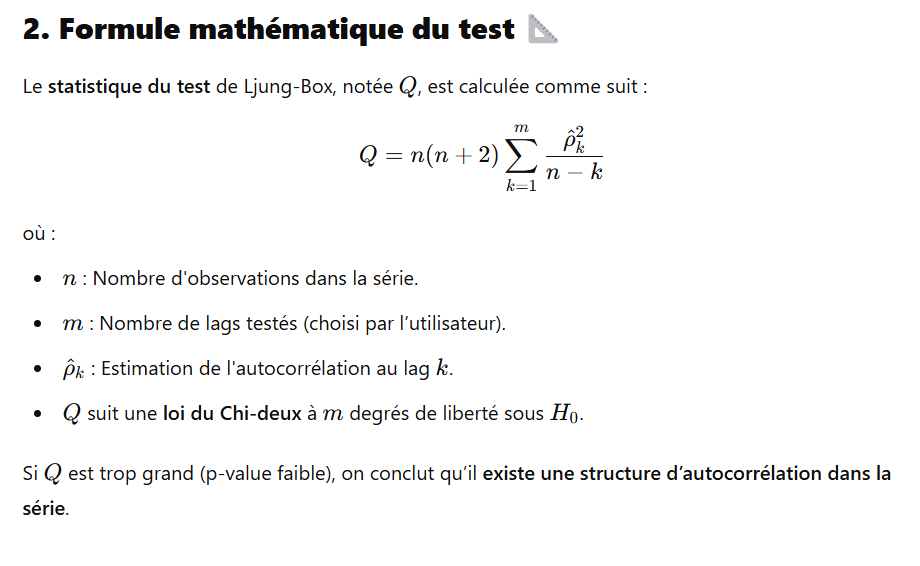

## Garch sur les bruits 

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/tmp/ipykernel_137968/4026576087.py:30: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.


/opt/conda/lib/python3.12/site-package

Test de Ljung-Box (p-value) : 0.0198

Modélisation de la volatilité des résidus avec GARCH(1,1)...
                     Constant Mean - GARCH Model Results                      
Dep. Variable:              residuals   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                3337.37
Distribution:                  Normal   AIC:                          -6662.74
Method:            Maximum Likelihood   BIC:                          -6639.47
                                        No. Observations:                  357
Date:                Wed, Mar 19 2025   Df Residuals:                      356
Time:                        23:04:24   Df Model:                            1
                                  Mean Model                                  
                  coef    std err          t      P>|t|       95.0% Conf. Int.
--------------------------------

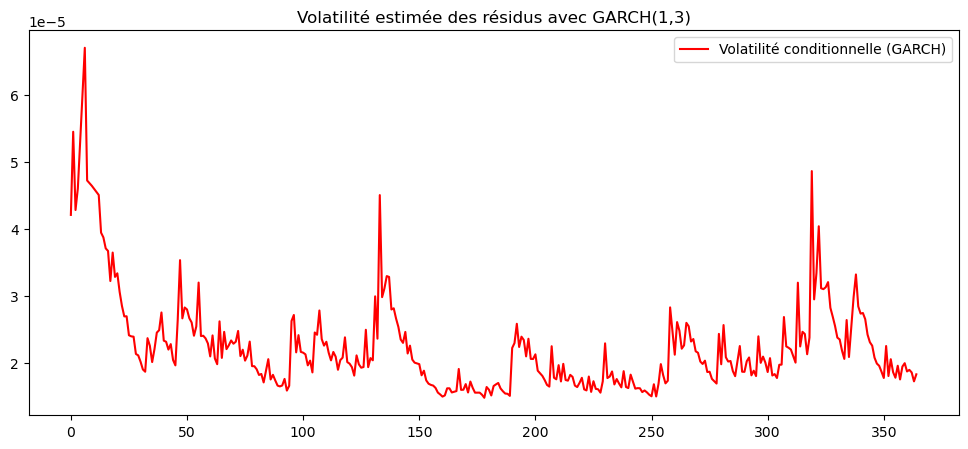

In [17]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller, kpss
from arch.unitroot import PhillipsPerron
from statsmodels.tsa.arima.model import ARIMA
from arch import arch_model

def analyse_bruit_arima(coin, plateform, type, without_outliers):
    # Sélection du DataFrame
    df_key = f"new-{type}-{plateform}-{coin}" if without_outliers else f"{type}-{plateform}-{coin}"
    if df_key not in dataframes:
        raise KeyError(f"Le DataFrame {df_key} n'existe pas dans dataframes.")
    df_grouped = dataframes[df_key].copy()
    
    # Transformation : Logarithme
    df_grouped["price_log"] = np.log(df_grouped["price"])  # Y_t = log(X_t)
    
    # Modélisation ARIMA (p, d, q) = (3,1,3)
    model = ARIMA(df_grouped["price_log"].dropna(), order=(3,1,3))
    results = model.fit()
    
    # Extraction des résidus (bruits)
    df_grouped["residuals"] = results.resid
    
    # Vérification de la stationnarité des bruits
    adf_test = adfuller(df_grouped["residuals"].dropna())
    pp_test = PhillipsPerron(df_grouped["residuals"].dropna()).pvalue
    kpss_test = kpss(df_grouped["residuals"].dropna(), regression='c')
    
    # print(f"Tests de stationnarité des bruits de l'ARIMA ({plateform}-{coin} - {type})")
    # print(f"  - ADF p-value: {np.round(adf_test[1], 4)}")
    # print(f"  - PP p-value: {np.round(pp_test, 4)}")
    # print(f"  - KPSS p-value: {np.round(kpss_test[1], 4)}")
    
    # # Tracer les graphiques
    # fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    
    # # ACF et PACF des résidus
    # sm.graphics.tsa.plot_acf(df_grouped["residuals"].dropna(), ax=axes[0], lags=20)
    # axes[0].set_title("Autocorrelation (ACF) des bruits ARIMA")
    
    # sm.graphics.tsa.plot_pacf(df_grouped["residuals"].dropna(), ax=axes[1], lags=20)
    # axes[1].set_title("Autocorrelation Partielle (PACF) des bruits ARIMA")
    
    # # Histogramme des résidus
    # axes[2].hist(df_grouped["residuals"].dropna(), bins=30, density=True, alpha=0.7, color='blue')
    # axes[2].set_title("Histogramme des bruits ARIMA (distribution)")
    
    # plt.show()
    
    # Test de Ljung-Box
    ljung_box_p_values = sm.stats.acorr_ljungbox(df_grouped["residuals"].dropna(), lags=[10], return_df=True)
    print(f"Test de Ljung-Box (p-value) : {ljung_box_p_values['lb_pvalue'].values[0]:.4f}")
    
    # Analyse de la volatilité avec un modèle ARCH/GARCH
    print("\nModélisation de la volatilité des résidus avec GARCH(1,1)...")
    garch_model = arch_model(df_grouped["residuals"].dropna(), vol='Garch', p=1, q=3)
    garch_results = garch_model.fit(disp='off')
    print(garch_results.summary())
    
    # Tracé de la volatilité estimée
    plt.figure(figsize=(12, 5))
    plt.plot(garch_results.conditional_volatility, label="Volatilité conditionnelle (GARCH)", color='red')
    plt.title("Volatilité estimée des résidus avec GARCH(1,3)")
    plt.legend()
    plt.show()
    
    return df_grouped["residuals"].dropna()

# Exemple d'appel de la fonction
bruit = analyse_bruit_arima("usdc", "kraken", "day", True)


# Réseau neuronne (LSTM)

In [15]:
pip install tensorflow

Note: you may need to restart the kernel to use updated packages.


In [14]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error

def create_sequences(data, seq_length):
    """Crée des séquences pour l'entraînement du modèle LSTM"""
    X, y = [], []
    for i in range(len(data) - seq_length):
        X.append(data[i:i + seq_length])
        y.append(data[i + seq_length])
    return np.array(X), np.array(y)

def LSTM_model(coin, plateform, type, without_outliers, validation_points=5, sequence_length=10):
    # Sélection du DataFrame en fonction du paramètre without_outliers
    if without_outliers:
        df_key = f"new-{type}-{plateform}-{coin}"
    else:
        df_key = f"{type}-{plateform}-{coin}"
    
    if df_key not in dataframes:
        raise KeyError(f"Le DataFrame {df_key} n'existe pas dans dataframes.")
    df_grouped = dataframes[df_key].copy()
    
    # Transformation : Logarithme (comme dans votre modèle ARIMA)
    df_grouped["price_log"] = np.log(df_grouped["price"])
    
    # Séparation des données d'entraînement et de validation
    train_data = df_grouped.iloc[:-validation_points].copy()
    validation_data = df_grouped.iloc[-validation_points:].copy()
    
    print(f"Taille des données d'entraînement: {len(train_data)}")
    print(f"Taille des données de validation: {len(validation_data)}")
    
    # Normalisation des données (important pour les réseaux de neurones)
    scaler = MinMaxScaler(feature_range=(0, 1))
    train_scaled = scaler.fit_transform(train_data["price_log"].values.reshape(-1, 1))
    
    # Préparation des séquences pour l'entraînement
    X_train, y_train = create_sequences(train_scaled, sequence_length)
    
    # Reshape input pour le format LSTM [samples, time steps, features]
    X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
    
    # Création du modèle LSTM
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
    model.add(Dropout(0.2))
    model.add(LSTM(units=50, return_sequences=False))
    model.add(Dropout(0.2))
    model.add(Dense(units=1))
    
    # Compilation du modèle
    model.compile(optimizer='adam', loss='mean_squared_error')
    
    # Early stopping pour éviter le surapprentissage
    early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
    
    # Entraînement du modèle
    history = model.fit(
        X_train, y_train,
        epochs=100,
        batch_size=32,
        validation_split=0.2,
        callbacks=[early_stop],
        verbose=1
    )
    
    # Prédictions sur les données d'entraînement
    train_predict = model.predict(X_train)
    
    # Inverse de la normalisation
    train_predict = scaler.inverse_transform(train_predict)
    
    # Préparation des données pour la prédiction out-of-sample
    # On prend les dernières sequence_length observations de l'ensemble d'entraînement
    last_sequence = train_scaled[-sequence_length:].reshape(1, sequence_length, 1)
    
    # Prédictions pour les points de validation
    out_sample_pred = []
    current_batch = last_sequence
    
    for i in range(validation_points):
        # Prédire la prochaine valeur
        current_pred = model.predict(current_batch)[0]
        # Ajouter à nos prédictions
        out_sample_pred.append(current_pred[0])
        # Mettre à jour la séquence pour la prochaine prédiction
        current_batch = np.append(current_batch[:, 1:, :], [[current_pred]], axis=1)
    
    # Inverse de la normalisation pour les prédictions out-of-sample
    out_sample_pred = scaler.inverse_transform(np.array(out_sample_pred).reshape(-1, 1))
    
    # Évaluation sur les données de validation
    validation_actual = validation_data["price_log"].values.reshape(-1, 1)
    
    mse = mean_squared_error(validation_actual, out_sample_pred)
    mae = mean_absolute_error(validation_actual, out_sample_pred)
    rmse = np.sqrt(mse)
    
    print(f"Métriques d'évaluation LSTM sur les données de validation:")
    print(f"  - MSE (Mean Squared Error): {mse:.6f}")
    print(f"  - RMSE (Root Mean Squared Error): {rmse:.6f}")
    print(f"  - MAE (Mean Absolute Error): {mae:.6f}")
    
    # Création de la figure pour la visualisation
    fig = go.Figure()
    
    # Tracé des valeurs réelles
    fig.add_trace(go.Scatter(
        x=df_grouped["time"],
        y=df_grouped["price_log"],
        mode='lines',
        name="Original Log Price",
        marker=dict(color='red'),
    ))
    
    # Préparation des prédictions in-sample pour la visualisation
    # Décalage pour aligner avec les timestamps correspondants
    in_sample_indices = train_data.index[sequence_length:]
    in_sample_times = train_data.loc[in_sample_indices, "time"]
    
    # Tracé des prédictions in-sample
    fig.add_trace(go.Scatter(
        x=in_sample_times,
        y=train_predict.flatten(),
        mode='lines',
        name='LSTM In-Sample Forecast',
        line=dict(color='blue')
    ))
    
    # Tracé des prédictions out-of-sample
    fig.add_trace(go.Scatter(
        x=validation_data["time"],
        y=out_sample_pred.flatten(),
        mode='lines',
        name='LSTM Out-of-Sample Forecast',
        line=dict(color='green', dash='dash')
    ))
    
    # Ajout d'une ligne verticale séparant les données d'entraînement et de validation
    split_time = train_data["time"].iloc[-1]
    fig.add_shape(
        type="line",
        x0=split_time,
        y0=df_grouped["price_log"].min(),
        x1=split_time,
        y1=df_grouped["price_log"].max(),
        line=dict(color="black", width=1, dash="dot"),
    )
    
    # Mise en forme
    fig.update_layout(
        title=f"LSTM Forecast - {plateform} - {coin} ({type}) - {validation_points} points validation",
        xaxis_title="Time",
        yaxis_title="Log Price",
        template="plotly_white",
        legend=dict(x=0, y=1),
        width=1500,
        height=600
    )
    
    # Tracé de l'historique d'apprentissage
    loss_fig = go.Figure()
    loss_fig.add_trace(go.Scatter(
        y=history.history['loss'],
        name='Train Loss'
    ))
    loss_fig.add_trace(go.Scatter(
        y=history.history['val_loss'],
        name='Validation Loss'
    ))
    loss_fig.update_layout(
        title='Model Loss During Training',
        xaxis_title='Epoch',
        yaxis_title='Loss',
        template="plotly_white",
        width=1000,
        height=400
    )
    
    return fig, loss_fig, model, mse, rmse, mae

# Fonction pour comparer ARIMA et LSTM
def compare_models(coin, plateform, type, without_outliers, validation_points=5,sequence_length = 10):
    # Exécution du modèle ARIMA
    arima_fig, arima_mse, arima_rmse, arima_mae = ARIMA_log(coin, plateform, type, without_outliers, validation_points)
    
    # Exécution du modèle LSTM
    lstm_fig, lstm_loss_fig, lstm_model, lstm_mse, lstm_rmse, lstm_mae = LSTM_model(coin, plateform, type, without_outliers, validation_points)
    
    # Création d'un tableau comparatif
    comparison_data = {
        'Métrique': ['MSE', 'RMSE', 'MAE'],
        'ARIMA': [arima_mse, arima_rmse, arima_mae],
        'LSTM': [lstm_mse, lstm_rmse, lstm_mae]
    }
    
    comparison_df = pd.DataFrame(comparison_data)
    
    print("Comparaison des modèles ARIMA et LSTM:")
    print(comparison_df)
    
    # Création d'un graphique comparatif des métriques
    metrics_fig = go.Figure()
    
    metrics_fig.add_trace(go.Bar(
        x=comparison_df['Métrique'],
        y=comparison_df['ARIMA'],
        name='ARIMA'
    ))
    
    metrics_fig.add_trace(go.Bar(
        x=comparison_df['Métrique'],
        y=comparison_df['LSTM'],
        name='LSTM'
    ))
    
    metrics_fig.update_layout(
        title="Comparaison des métriques ARIMA vs LSTM",
        xaxis_title="Métrique",
        yaxis_title="Valeur",
        barmode='group',
        template="plotly_white",
        width=1000,
        height=500
    )
    
    return arima_fig, lstm_fig, metrics_fig, comparison_df, lstm_model

# Exemple d'appel
arima_fig, lstm_fig, metrics_fig, comparison_df, lstm_model = compare_models("usdc", "kraken", "day", True, validation_points=5, sequence_length = 20)

# Affichage des figures
arima_fig.show()
lstm_fig.show()
metrics_fig.show()
print(comparison_df)

Taille des données d'entraînement: 352
Taille des données de validation: 5
Stationarity tests after log transformation for kraken-usdc (day data):
  - ADF p-value: 0.1181
  - PP p-value: 0.0
  - KPSS p-value: 0.01


/tmp/ipykernel_137968/3444668430.py:35: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.


/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

An unsupported index was provided. As a result, forecasts cannot be generated. To use the model for forecasting, use one of the supported classes of index.



                               SARIMAX Results                                
Dep. Variable:              price_log   No. Observations:                  352
Model:                 ARIMA(3, 1, 3)   Log Likelihood                3252.116
Date:                Wed, 19 Mar 2025   AIC                          -6490.233
Time:                        22:39:19   BIC                          -6463.207
Sample:                             0   HQIC                         -6479.477
                                - 352                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7306   2.51e-20  -2.91e+19      0.000      -0.731      -0.731
ar.L2          0.2231   4.89e-20   4.56e+18      0.000       0.223       0.223
ar.L3          0.0999   2.83e-20   3.54e+18      0.0

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:837: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.

/opt/conda/lib/python3.12/site-packages/statsmodels/tsa/base/tsa_model.py:837: FutureWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

/opt/conda/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:200: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



9/9 ━━━━━━━━━━━━━━━━━━━━ 3s 68ms/step - loss: 0.2440 - val_loss: 0.0184
Epoch 2/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0228 - val_loss: 0.0356
Epoch 3/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0195 - val_loss: 0.0168
Epoch 4/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0175 - val_loss: 0.0193
Epoch 5/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0152 - val_loss: 0.0227
Epoch 6/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0134 - val_loss: 0.0177
Epoch 7/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0126 - val_loss: 0.0200
Epoch 8/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0126 - val_loss: 0.0202
Epoch 9/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - loss: 0.0099 - val_loss: 0.0193
Epoch 10/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 0.0115 - val_loss: 0.0193
Epoch 11/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0106 - val_loss: 0.0210
Epoch 12/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.0111 - val_loss: 0.0193
E

  Métrique         ARIMA          LSTM
0      MSE  9.726308e-11  1.350754e-10
1     RMSE  9.862205e-06  1.162220e-05
2      MAE  7.619413e-06  1.014443e-05


## On pourrait peut etre ajouter des features, comme la volatilité, les valeurs des différences entre 2 consécutifs ... 